## Step-by-Step: Visualise Image + Mask


### Step 1 : Imports

- `rasterio`
    - reads and manipulates raster (image) files like .tif

- `numpy`
    - standard Python library for array operations

- `matplotlib.pyplot`
    - visualisation library — like Excel charts for code

- `json`
    - loads your annotation file into a Python dictionary

- `shapely`
    - creates polygon geometry from coordinate points

- `rasterio.features.rasterize`
    - converts vector shapes into pixel grids

In [1]:
# Imports

import rasterio
import numpy as np
import matplotlib.pyplot as plt
import json
from shapely.geometry import Polygon
from rasterio.features import rasterize


### Step 2: Load annotations file

- The .json file contains annotation data.

- `json.load(f)` reads the file into a Python dictionary.
    - You now have access to all "images" and "annotations" in that JSON.



In [2]:
# Load the JSON annotations

# Load the annotations file
with open("data/train_annotations.json") as f:
    annotations_data = json.load(f)


In [3]:
annotations_data

{'images': [{'file_name': '10cm_train_1.tif',
   'width': 1024,
   'height': 1024,
   'cm_resolution': 10,
   'scene_type': 'agriculture_plantation',
   'annotations': [{'class': 'individual_tree',
     'confidence_score': 1.0,
     'segmentation': [4.0,
      146.0,
      18.0,
      149.0,
      17.0,
      160.0,
      6.0,
      162.0,
      0.0,
      152.0]},
    {'class': 'individual_tree',
     'confidence_score': 1.0,
     'segmentation': [29.0,
      158.0,
      31.0,
      166.0,
      22.0,
      172.0,
      16.0,
      164.0,
      22.0,
      156.0]},
    {'class': 'individual_tree',
     'confidence_score': 1.0,
     'segmentation': [42.0,
      176.0,
      55.0,
      180.0,
      61.0,
      191.0,
      48.0,
      197.0,
      37.0,
      186.0]},
    {'class': 'individual_tree',
     'confidence_score': 1.0,
     'segmentation': [56.0, 194.0, 63.0, 197.0, 60.0, 205.0, 49.0, 201.0]},
    {'class': 'individual_tree',
     'confidence_score': 1.0,
     'segmentation

### Step 3: Extract relevant annotations

We want to match annotations to the exact image we're loading.

- The JSON is structured like:
```python
{
  "images": [
    {
      "file_name": "10cm_train_1.tif",
      "annotations": [ ... ]
    }
  ]
}
```

- `next(...)` finds the first (and only) matching image entry for "10cm_train_1.tif".
    - We then extract its corresponding "annotations" list.

- Each item in the **annotations** list looks like;
```python
{
  "class": "individual_tree",
  "segmentation": [x1, y1, x2, y2, ..., xn, yn]
}
```

Each dictionary entry in **annotations** represents one tree, containing its class type and segmentation location, which will become polygon coordinates.

In [4]:
# Extract image and matching annotations

# Choose a file to work with
image_filename = "10cm_train_12.tif"

# Get the matching record from the JSON
image_record = next(item for item in annotations_data["images"] if item["file_name"] == image_filename)

# Get the polygon segmentations
annotations = image_record["annotations"]

annotations

[{'class': 'individual_tree',
  'confidence_score': 1.0,
  'segmentation': [668.0,
   0.0,
   680.802,
   7.052,
   685.0,
   18.0,
   701.0,
   21.0,
   698.0,
   34.0,
   709.0,
   42.0,
   701.0,
   60.0,
   701.0,
   74.0,
   708.0,
   85.0,
   702.0,
   96.0,
   693.0,
   115.0,
   690.0,
   131.0,
   684.0,
   143.0,
   668.0,
   146.0,
   648.0,
   154.0,
   635.0,
   144.0,
   621.0,
   150.0,
   609.0,
   154.0,
   602.0,
   141.0,
   587.0,
   120.0,
   572.0,
   123.0,
   565.0,
   107.0,
   569.0,
   95.0,
   560.0,
   77.0,
   562.0,
   64.0,
   572.0,
   51.0,
   574.0,
   40.0,
   576.0,
   32.0,
   593.0,
   14.0,
   605.0,
   12.0,
   602.0,
   0.0]},
 {'class': 'individual_tree',
  'confidence_score': 1.0,
  'segmentation': [676.786,
   188.811,
   684.0,
   200.0,
   696.0,
   215.0,
   698.0,
   232.0,
   692.0,
   242.0,
   695.0,
   258.0,
   696.0,
   268.0,
   684.0,
   274.0,
   671.0,
   272.0,
   675.0,
   284.0,
   679.0,
   308.0,
   653.0,
   316.0,
   646

### Step 4: Convert to Polygons

Each `"segmentation"` list, which will be the polygon coordinates for an individual tree, is a flat list of numbers: [x1, y1, x2, y2, ..., xn, yn]

- Convert list of numbers into a 2D Numpy Array
    - `np.array().reshape(-1,2)`
        - ```python
            [[x1, y1],
            [x2, y2],
            ...
            [xn, yn]]
        ```

- Convert 2D Numpy Array of `"segmentation"` data into a geometric object for coordinates
    - ```python
        from shapely.geometry import Polygon

        Polygon(...)

        ``` 
    -  Polygon() from shapely turns these coordinate pairs into a geometry object.

In [5]:
# Convert Segments to polygons

from shapely.geometry import Polygon

# polygons = [
#     Polygon(np.array(ann["segmentation"]).reshape(-1, 2))
#     for ann in annotations if ann["segmentation"]
# ]

polygons_with_class = [
    {
        "geometry": Polygon(np.array(ann["segmentation"]).reshape(-1, 2)),
        "class": ann["class"]
    }
    for ann in annotations if "segmentation" in ann
]

polygons_with_class

[{'geometry': <POLYGON ((668 0, 680.802 7.052, 685 18, 701 21, 698 34, 709 42, 701 60, 701...>,
  'class': 'individual_tree'},
 {'geometry': <POLYGON ((676.786 188.811, 684 200, 696 215, 698 232, 692 242, 695 258, 696...>,
  'class': 'individual_tree'},
 {'geometry': <POLYGON ((675 362, 680 367, 691 374, 695 395, 695 409, 698 422, 685 448, 67...>,
  'class': 'individual_tree'},
 {'geometry': <POLYGON ((702 575, 695 581, 696 596, 682 601, 674 613, 668 610, 671 624, 66...>,
  'class': 'individual_tree'},
 {'geometry': <POLYGON ((697.108 678.055, 701 687, 700 701, 693 708, 691 720, 691 738, 678...>,
  'class': 'individual_tree'},
 {'geometry': <POLYGON ((662 783, 665 793, 673 798, 675 816, 665 820, 664 836, 652 839, 65...>,
  'class': 'individual_tree'},
 {'geometry': <POLYGON ((669 885, 665 897, 671 914, 673 930, 661 949, 647 961, 621.992 964...>,
  'class': 'individual_tree'},
 {'geometry': <POLYGON ((607 996, 621 992, 631 996, 640 995, 650 996, 662 1004, 668 1011, ...>,
  'class': 'ind

### Step 5: Open the Image & Read Metadata

- Identify the metadata of each image
    - src.meta
        - 3 Bands identified

- `src.read([1, 2, 3])`
    - Reads the 3 RGB bands (Red, Green, Blue)
        - An output for a rasterio.read() is:
            -`RGB Band Number, height (row), column (width)`

- `np.transpose(image, (1, 2, 0))`
    - Reorder the rasterio output so it can be input correct to `matplotlib.plplot.imshow()` visualisation plot
        - Visualisation Plot input order is:
            - `(height (row), column (width), RGB Band Number)`

- `src.transform`
    - Tells us how pixel coordinates relate to real-world space (important for raster alignment)
    - Transforming them to geometric data(?)

- `out_shape`
    - is the required height & width of the image; needed for mask raster size
    - This is the exact size and reference your output mask must match.

In [6]:
# Open the raster image
image_path = f"data/train_images/{image_filename}"


with rasterio.open(image_path) as src:

    src.meta
    # Use .meta to identify count of Bands
src.meta

/opt/anaconda3/envs/MLenv3.10/lib/python3.10/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


{'driver': 'GTiff',
 'dtype': 'uint8',
 'nodata': None,
 'width': 1024,
 'height': 1024,
 'count': 3,
 'crs': None,
 'transform': Affine(1.0, 0.0, 0.0,
        0.0, 1.0, 0.0)}

In [7]:
# Open the image and transform info

# Open the raster image
image_path = f"data/train_images/{image_filename}"


with rasterio.open(image_path) as src:
    image = src.read([1, 2, 3])  # RGB bands
    image = np.transpose(image, (1, 2, 0))  # (height, width, RGB)
    transform = src.transform
    out_shape = (src.height, src.width)


### Step 6: Rasterize the Polygons

- `rasterize()`
    - Takes vector data (polygons) and creates a 2D array (like a grayscale image)

    - For Geometric data in Polygon variable, True responses;
        - Each pixel inside a polygon gets value 1
     
    - `Fill = 0`
        - Therefore Each pixel outside a polygon (not True for geom in geom) is filled with 0

    - Creates a binary segmentation mask aligned with the original image.

- transform = our transform data


This is your label for training machine learning models.

In [8]:
# Rasterize the polygons into a binary mask

class_to_value = {
    'individual_tree': 1,
    'group_of_trees': 2,
}


mask = rasterize(
    [(entry["geometry"], class_to_value.get(entry["class"], 0)) for entry in polygons_with_class],
    out_shape=out_shape,
    transform=transform,
    fill=0,
    dtype='uint8'
)

print(set(entry['class'] for entry in polygons_with_class))


{'individual_tree'}


### Step 7: Plot Image and Mask Side-by-Side

- `fig, ax = plt.subplots(...)`
    - creates two plots side by side

- `ax[0].imshow(image)`
    - plots the RGB satellite photo in subplot 0

- `ax[1].imshow(mask)`
    -  plots the binary mask (1 = tree, 0 = background) in subbplot 1
- `cmap='Greens'`
    - shows the mask in shades of green
- `axis('off')`
    - removes axis labels for a cleaner look

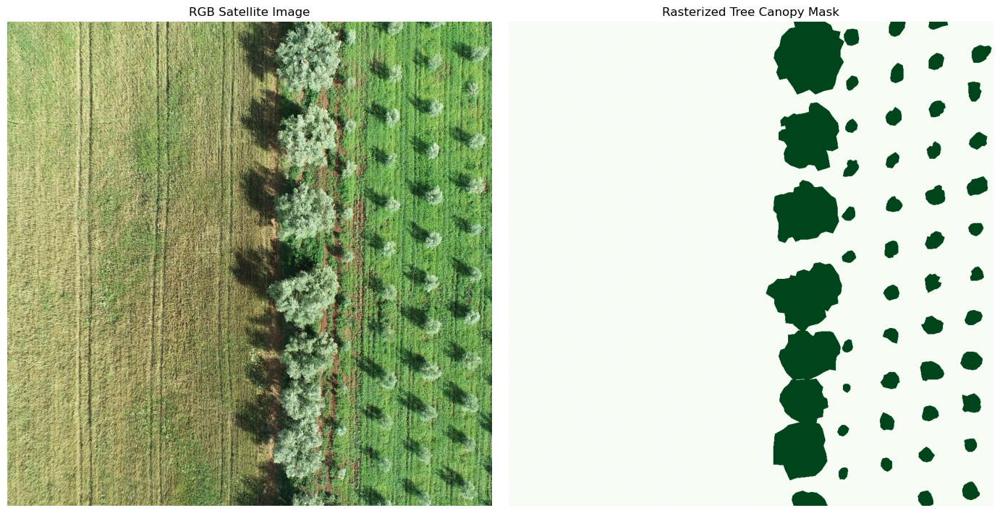

In [9]:
# Plot image and mask side by side

fig, ax = plt.subplots(1, 2, figsize=(14, 7))

# Original image
ax[0].imshow(image)
ax[0].set_title("RGB Satellite Image")
ax[0].axis('off')

# Mask
ax[1].imshow(mask, cmap='Greens')
ax[1].set_title("Rasterized Tree Canopy Mask")
ax[1].axis('off')

plt.tight_layout()
plt.show()


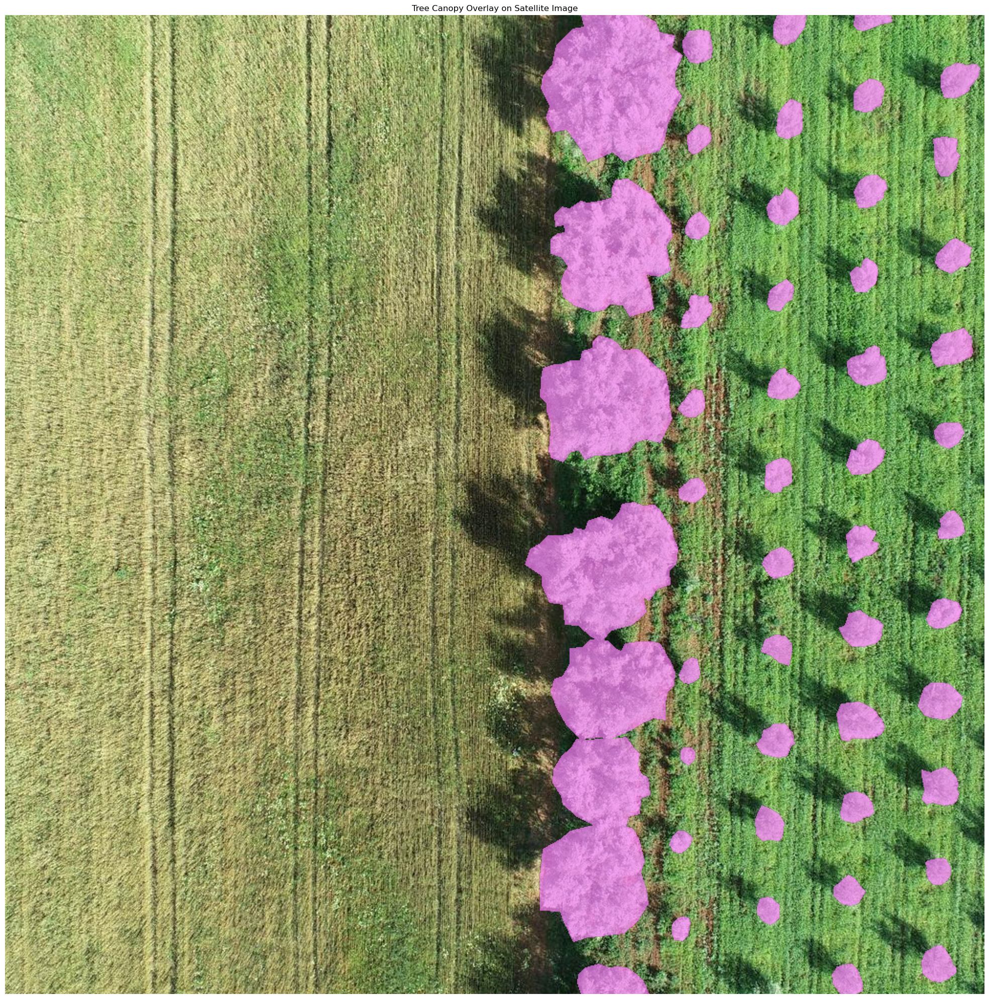

In [10]:
from matplotlib.colors import ListedColormap
import numpy as np



from matplotlib.colors import ListedColormap, BoundaryNorm

# Define consistent colour mapping
class_labels = [0, 1, 2]  # 0 = background, 1 = individual_tree, 2 = group_of_trees
colors = [
    (0, 0, 0, 0),      # 0 = transparent
    (1, 0.5, 1, 1),    # 1 = pink (individual_tree)
    (0, 1, 1, 1)       # 2 = cyan (group_of_trees)
]

# Create colormap and explicit boundaries
cmap = ListedColormap(colors)
norm = BoundaryNorm(class_labels + [max(class_labels)+1], cmap.N)






# Plot single image with overlay
fig, ax = plt.subplots(figsize=(30, 20))

# 1. Plot the base RGB image
ax.imshow(image)
ax.set_title("Tree Canopy Overlay on Satellite Image")
ax.axis('off')


# 2. Overlay the binary mask as transparent green
ax.imshow(mask, cmap=cmap, norm=norm, alpha=0.7)  # alpha controls transparency
# You can use 'spring', 'Greens', or a custom colormap

plt.tight_layout()
plt.show()


In [11]:
print(set([entry["class"] for entry in polygons_with_class]))

{'individual_tree'}
